In [1]:
import pandas as pd

In [2]:
complaints = pd.read_csv("complaints-2018-2021.csv", header=0)

In [3]:
complaints['Date received'] = pd.to_datetime(complaints['Date received'])

In [153]:
complaints_2018 = complaints[complaints['Date received'].dt.year == 2018]

In [5]:
print(complaints.columns)
print(complaints.shape)

Index(['Date received', 'Product', 'Sub-product', 'Issue', 'Sub-issue',
       'Consumer complaint narrative', 'Company public response', 'Company',
       'State', 'ZIP code', 'Tags', 'Consumer consent provided?',
       'Submitted via', 'Date sent to company', 'Company response to consumer',
       'Timely response?', 'Consumer disputed?', 'Complaint ID'],
      dtype='object')
(1474850, 18)


In [6]:
print(complaints_2018)

        Date received                                            Product  \
2          2018-07-12                                    Debt collection   
6          2018-06-11  Credit reporting, credit repair services, or o...   
7          2018-10-15                        Credit card or prepaid card   
10         2018-06-11                                           Mortgage   
14         2018-06-11                        Credit card or prepaid card   
...               ...                                                ...   
1474837    2018-04-26                                    Debt collection   
1474838    2018-03-19                                       Student loan   
1474840    2018-03-16                                       Student loan   
1474841    2018-03-10          Payday loan, title loan, or personal loan   
1474842    2018-02-13                                           Mortgage   

                                        Sub-product  \
2                               

In [154]:
complaint_narratives_2018 = complaints_2018['Consumer complaint narrative'].dropna()
complaint_2018_ = complaints_2018.dropna(subset=['Consumer complaint narrative'])
print(complaint_2018_.shape, complaint_narratives_2018.shape)

(118438, 18) (118438,)


In [8]:
from bertopic import BERTopic

/Users/keshen/opt/anaconda3/envs/ISI-new/lib/python3.8/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/Users/keshen/opt/anaconda3/envs/ISI-new/lib/python3.8/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/Users/keshen/opt/anaconda3/envs/ISI-new/lib/python3.8/site-

In [9]:
from sentence_transformers import SentenceTransformer
from umap import UMAP
from hdbscan import HDBSCAN

In [10]:
model = SentenceTransformer('all-MiniLM-L6-v2')
model

SentenceTransformer(
  (0): Transformer({'max_seq_length': 256, 'do_lower_case': False}) with Transformer model: BertModel 
  (1): Pooling({'word_embedding_dimension': 384, 'pooling_mode_cls_token': False, 'pooling_mode_mean_tokens': True, 'pooling_mode_max_tokens': False, 'pooling_mode_mean_sqrt_len_tokens': False})
  (2): Normalize()
)

In [17]:
import numpy as np
from tqdm.auto import tqdm

batch_size = 32
n = complaint_narratives_2018.shape[0]
# print(n)
embeds = np.zeros((n, model.get_sentence_embedding_dimension()))

for i in tqdm(range(0, n, batch_size)):
    i_end = min(i+batch_size, n)
    batch = complaint_narratives_2018[i:i_end].values.tolist()
#     print(i)
    batch_embed = model.encode(batch)
    embeds[i:i_end,:] = batch_embed

  0%|          | 0/3702 [00:00<?, ?it/s]

In [72]:
le = preprocessing.LabelEncoder()
le.fit(complaint_2018_['Product'])
labels_encoded = le.transform(complaint_2018_['Product']) 


In [54]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
import plotly.graph_objects as go
from sklearn import preprocessing


In [77]:
import umap

fit = umap.UMAP(n_neighbors=10, n_components=3, min_dist=1.0)
u = fit.fit_transform(embeds)

In [78]:
# jitter function, adjust scale parameter as needed
def add_jitter(arr, scale=0.02):
    return arr + np.random.normal(scale=scale, size=arr.shape)

jittered_u = add_jitter(u)


In [81]:
color_dict = {
    'Debt collection': '#E94F42',
    'Credit reporting, credit repair services, or other personal consumer reports': '#F5CB1D',
    'Mortgage': '#377EC2',
    'Credit card or prepaid card': '#036166',
    'Vehicle loan or lease': '#ADA579',
    'Student loan': '#A17DB4',
    'Checking or savings account': '#A6CEEE',
    'Money transfer, virtual currency, or money service': '#C19883',
    'Payday loan, title loan, or personal loan': '#797979',
}
# print(complaint_2018_vec['Product'].unique())
vec = pd.DataFrame(jittered_u, columns=['x', 'y', 'z'])
complaint_2018_vec = pd.concat([complaint_2018_, vec], axis=1)
product_types = complaint_2018_vec['Product'].unique()
data = []
for product in product_types:
    product_data = complaint_2018_vec[complaint_2018_vec['Product'] == product]

    scatter = go.Scatter3d(
        x=product_data['x'],  # replace with your x, y, z columns
        y=product_data['y'],
        z=product_data['z'],
        mode='markers',
        marker=dict(
            size=8,
            color=color_dict[product] if product in color_dict else'#C3C1C0',
            opacity=0.5,
        ),
        name=product
    )
    data.append(scatter)

layout = go.Layout(
    margin=dict(l=0, r=0, b=0, t=0)
)

fig = go.Figure(data=data, layout=layout)
fig.show()



<AxesSubplot: ylabel='$\\lambda$ value'>

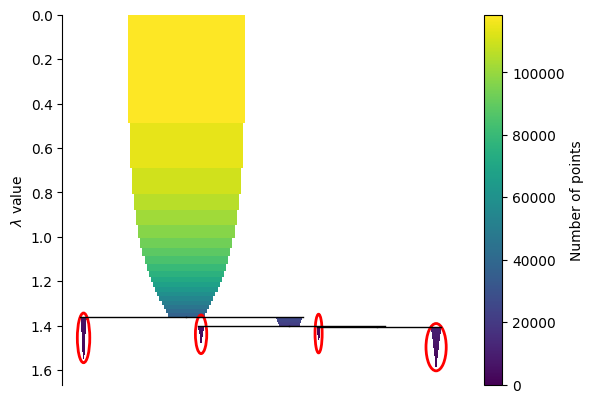

In [125]:
import hdbscan
import os
os.environ["TOKENIZERS_PARALLELISM"] = "false"

clusterer = hdbscan.HDBSCAN(
    min_cluster_size=1500, min_samples=300)
clusterer.fit(u)
clusterer.condensed_tree_.plot(select_clusters=True)

In [126]:
labels = clusterer.labels_

fig = go.Figure()

num_noise = np.sum(clusterer.labels_ == -1)

print(f'Number of noisy nodes: {num_noise}')

# For each cluster label, create a separate trace (scatter plot)
for cluster_label in np.unique(labels):

    # If cluster_label is -1, the point is considered as noise by HDBSCAN
    if cluster_label == -1:
        name = 'Noise'
        color = 'rgba(0, 0, 0, 0)'  # Black for noise points
        alpha = 0
    else:
        name = f'Cluster {cluster_label}'
        color = None  # Plotly will use default colors

    # Select points belonging to the current cluster (or noise)
    idx = labels == cluster_label
    x, y, z = u[idx, 0], u[idx, 1], u[idx, 2]

    # Add this cluster to the figure
    fig.add_trace(
        go.Scatter3d(
            x=x, y=y, z=z, mode='markers', marker=dict(size=3, color=color), name=name
        )
    )

fig.update_layout(
    scene=dict(
        xaxis_title='UMAP 1',
        yaxis_title='UMAP 2',
        zaxis_title='UMAP 3'
    ),
    margin=dict(l=0, r=0, b=0, t=0)  # Tight layout
)

fig.show()

Number of noisy nodes: 92649


In [129]:
import re
import nltk
complaint_2018_['tokens'] = complaint_2018_['Consumer complaint narrative'].apply(nltk.word_tokenize)

# alpha = re.compile(r'\s')
# data = complaint_2018_.map(lambda x: {
#     'tokens': x['Consumer complaint narrative'].lower()
# })
# data = data.map(lambda x: {
#     'tokens': nltk.tokenize.wordpunct_tokenize(x['tokens'])
# })
# complaint_2018_

/var/folders/lq/lnf_6ck55vzg7tq115d5x0bw0000gp/T/ipykernel_59622/1152075863.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [143]:
from nltk.corpus import stopwords
import string

nltk.download('stopwords')  # if not already downloaded
stop_words = set(stopwords.words('english')) 

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/keshen/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [147]:
def remove_punctuation_and_lowercase(input_string):
    # replace punctuation with spaces
#     translator = str.maketrans(string.punctuation, ' '*len(string.punctuation))
    return input_string.lower()

def remove_stopwords(tokens):
    return [word for word in tokens if word not in stop_words]


In [155]:
complaint_2018_['Consumer complaint narrative'] = complaint_2018_['Consumer complaint narrative'].apply(remove_punctuation_and_lowercase)

complaint_2018_['tokens'] = complaint_2018_['Consumer complaint narrative'].apply(nltk.word_tokenize)
complaint_2018_['tokens'] = complaint_2018_['tokens'].apply(remove_stopwords)


/var/folders/lq/lnf_6ck55vzg7tq115d5x0bw0000gp/T/ipykernel_59622/459622316.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/lq/lnf_6ck55vzg7tq115d5x0bw0000gp/T/ipykernel_59622/459622316.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/lq/lnf_6ck55vzg7tq115d5x0bw0000gp/T/ipykernel_59622/459622316.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the docu

In [156]:
print(complaint_2018_.iloc[0]['tokens'])

['received', 'court', 'summons', 'xx/xx/2018', '.', 'immediately', 'called', 'law', 'firm', 'representing', 'debt', 'collector', 'order', 'establish', 'payment', 'plan', 'debt', '.', 'made', 'first', 'payment', 'day', '.', 'phone', 'call', ',', 'concerned', 'continuation', 'lawsuit', 'judgment', 'held', 'debt', ',', 'asked', 'representative', 'phone', 'answer', 'lawsuit', ',', 'advised', 'file', 'answer', ',', 'since', 'agreed', 'pay', 'monthly', '.', 'offered', 'settlement', 'via', 'email', 'law', 'firm', 'two', 'weeks', 'ago', 'roughly', 'half', 'amount', 'debt', 'never', 'answered', '.', 'called', 'court', 'today', '(', 'xx/xx/2018', ')', 'confirm', 'lawsuit', 'dismissed', ',', 'court', 'confirmed', 'law', 'suit', 'fact', 'dismissed', 'one', 'business', 'day', 'left', 'submit', 'answer', 'respond', 'law', 'suit', '.', 'called', 'law', 'firm', 'today', 'well', '(', 'xx/xx/2018', ')', 'right', 'inquired', 'debt', ',', 'law', 'suit', ',', 'would', 'willing', 'submit', 'voluntary', 'dis

In [158]:
complaint_2018_['class'] = clusterer.labels_


/var/folders/lq/lnf_6ck55vzg7tq115d5x0bw0000gp/T/ipykernel_59622/752379121.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [161]:
classes = {label: {'tokens': []} for label in set(clusterer.labels_)}
# add tokenized sentences to respective class
for index, row in complaint_2018_.iterrows():
    classes[row.loc['class']]['tokens'].extend(row['tokens'])


In [169]:
vocab = set([])
for tok in complaint_2018_['tokens'].tolist():
    for t in tok:
        vocab.add(t)
vocab = list(vocab)
print(len(vocab))

85719


In [172]:
import tqdm
tf = np.zeros((len(classes.keys()), len(vocab)))

for c, _class in enumerate(classes.keys()):
    for t, term in enumerate(tqdm.tqdm(vocab)):
        tf[c, t] = classes[_class]['tokens'].count(term)

100%|██████████████████████████████████| 85719/85719 [15:21:30<00:00,  1.55it/s]


In [173]:
tf

array([[1.710e+02, 1.000e+00, 0.000e+00, ..., 1.089e+03, 1.000e+00,
        0.000e+00],
       [1.100e+02, 0.000e+00, 0.000e+00, ..., 1.860e+02, 0.000e+00,
        0.000e+00],
       [2.100e+01, 0.000e+00, 0.000e+00, ..., 1.700e+01, 0.000e+00,
        0.000e+00],
       [4.100e+01, 0.000e+00, 0.000e+00, ..., 9.100e+01, 0.000e+00,
        0.000e+00],
       [1.273e+03, 0.000e+00, 2.000e+00, ..., 4.933e+03, 0.000e+00,
        1.000e+00]])

In [175]:
idf = np.zeros((1, len(vocab)))

# calculate average number of words per class
A = tf.sum() / tf.shape[0]

for t, term in enumerate(tqdm.tqdm(vocab)):
    # frequency of term t across all classes
    f_t = tf[:,t].sum()
    # calculate IDF
    idf_score = np.log(1 + (A / f_t))
    idf[0, t] = idf_score

100%|██████████████████████████████████| 85719/85719 [00:03<00:00, 22944.67it/s]


In [176]:
tf_idf = tf*idf

In [201]:
n=10000
top_idx = np.argpartition(tf_idf, -n)[:, -n:]

In [191]:
vlist = list(vocab)
for c, _class in enumerate(classes.keys()):
    topn_idx = top_idx[c, :]
    topn_terms = [vlist[idx] for idx in topn_idx]
#     print(topn_terms)
    topn_score = [tf_idf[c][idx] for idx in topn_idx]
    score_term_pairs = list(zip(topn_score, topn_terms))
    score_term_pairs.sort(reverse=True)
    sorted_scores, sorted_terms = zip(*score_term_pairs)
    sorted_terms = [word for word in sorted_terms if word not in stop_words and not re.match(r'\W+', word)]
    print(sorted_terms)

['xxxx', 'account', 'card', 'bank', 'xx/xx/xxxx', 'credit', 'told', 'would', 'called', 'money', 'back', 'received', 'america', 'said', 'charges', "n't", 'payment', 'charge', 'fraud', 'time', 'one', 'never', 'call', 'closed', 'check', 'could', 'made', 'customer', 'phone', 'number', 'get', 'dispute', 'service', 'xx/xx/2018', 'asked', 'days', 'pay', 'company', 'funds', 'sent', 'also', 'claim', 'amount', 'balance', 'information', 'letter', 'since', 'new', 'transaction', 'due', 'checking', 'fees', 'online', 'even', 'still', 'day', 'charged', 'email', 'citi', 'paid', 'merchant', 'went', 'department', 'another', 'make', 'us', 'business', 'two', 'refund', 'fee', 'transactions', 'help', 'know', 'issue', 'statement', 'contacted', 'late', 'debit', 'spoke', 'fraudulent', 'got', 'cards', 'close', 'representative', 'branch', 'use', 'used']
['xxxx', 'loan', 'xx/xx/xxxx', 'payment', 'mortgage', 'would', 'payments', 'told', 'car', 'modification', 'pay', 'time', 'received', 'get', 'home', 'called', 'bac

0


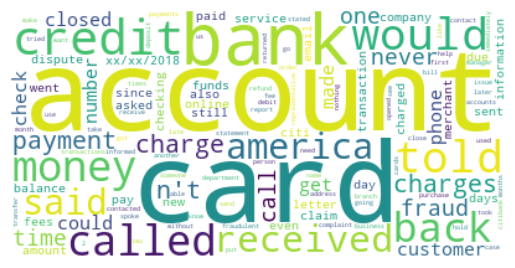

1


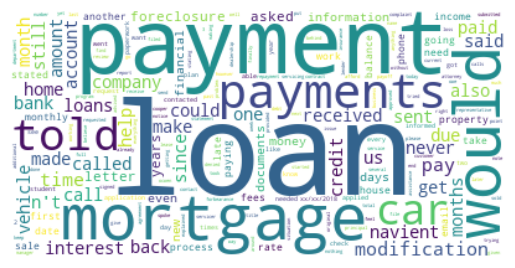

2


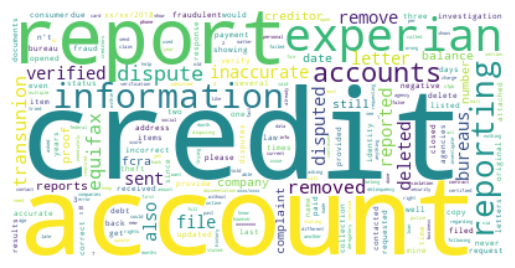

3


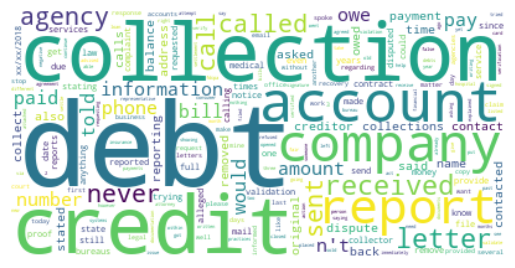

4


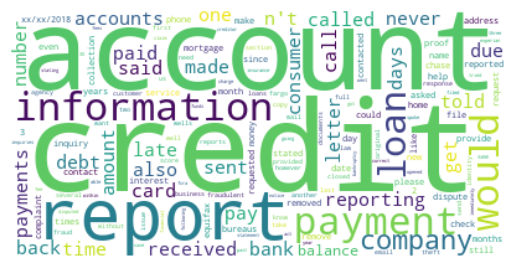

In [202]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt
vlist = list(vocab)
for c, _class in enumerate(classes.keys()):
    print(c)
    topn_idx = top_idx[c, :]
    topn_terms = [vlist[idx] for idx in topn_idx]
#     print(topn_terms)
    topn_score = [tf_idf[c][idx] for idx in topn_idx]
    topn_idx_update = [i for i in range(len(topn_terms)) if topn_terms[i] not in ['xxxx', 'xx/xx/xxxx'] and topn_terms[i] not in stop_words and not re.match(r'\W+', topn_terms[i])]
    topn_terms = [topn_terms[x] for x in topn_idx_update]
    topn_score = [topn_score[x] for x in topn_idx_update]

    wc = WordCloud(background_color="white", max_words=1000)
    wc.generate_from_frequencies(dict(zip(topn_terms, topn_score)))
    plt.imshow(wc, interpolation='bilinear')
    plt.axis('off')
    plt.show()

### Fine-grained

In [ ]:
from bertopic import BERTopic
from sklearn.feature_extraction.text import CountVectorizer
topics, probs = model.fit_transform(complaint_narratives_2018.values.tolist()[:10000])
freq = model.get_topic_info()
freq.head(50)